In [1]:
from functions import *


WIKIART ANALYSIS

In [2]:
def print_metrics(dataset_name, viz = True):
    i = 1
    if dataset_name == "wikiart":
        if viz:
            df = pd.read_pickle('DATA/Dataset/wikiart/wikiart_full_combined_no_artist_filtered.pkl')
        features = ["image_features", "image_text_features"]
    elif dataset_name == "fashion":
        if viz:
            df = pd.read_pickle('DATA/Dataset/iDesigner/idesigner_influences_cropped_features_mode.pkl')
        features = ["image_features"]
    feature_extractors = ["ResNet34_newsplit","random_artists"]
    sampling_strategies = ["posrandom", "posfaiss"]
    num_examples = ["10", "100"]
    dataset_name = "wikiart"
    for feature in features:
        for feature_extractor in feature_extractors:
            if viz:
                if feature_extractor == "ResNet34_newsplit" :
                    df = split_by_strata_artist(df) 
                elif feature_extractor == "random_artists":
                    df = split_by_artist_random(df)
            path = f'trained_models/{dataset_name}/{feature_extractor}/baseline_IR_metrics/{feature}_val.pth'
            IR_baseline = torch.load(path)
            print(f'BASELINE with {feature_extractor}, {feature}')
            print_mean_metrics(IR_baseline)
            print('     ')
            for num_example in num_examples:
                for sampling_strategy in sampling_strategies:
                    path = f'trained_models/{dataset_name}/{feature_extractor}/TripletResNet_{feature}_{sampling_strategy}_negrandom_{num_example}_margin1_notrans_epoch_30/IR_metrics/metrics_val.pth'
                    IR_metrics = torch.load(path)
                    print(f'Experiment:{feature_extractor}, {feature}, {sampling_strategy} and {num_example} ')
                    print_mean_metrics(IR_metrics)
                    if viz:
                        indices = df[(df['mode'] == 'val') & (df['artist_name'] == 'vincent-van-gogh')].index.tolist()
                        plot_examples(dataset_name, indices[i],IR_metrics['retrieved_indexes'][indices[i]], df)
                    print('    ')
            print('----------')

In [3]:
print_metrics("wikiart", False)

BASELINE with ResNet34_newsplit, image_features
Pk: 0.099, MRR: 0.188
2Pk: 0.158, 2MRR: 0.279
     
Experiment:posrandom and 10 
Pk: 0.144, MRR: 0.238
2Pk: 0.198, 2MRR: 0.31
    
Experiment:posfaiss and 10 
Pk: 0.111, MRR: 0.217
2Pk: 0.172, 2MRR: 0.304
    
Experiment:posrandom and 100 
Pk: 0.161, MRR: 0.25
2Pk: 0.216, 2MRR: 0.321
    
Experiment:posfaiss and 100 
Pk: 0.175, MRR: 0.276
2Pk: 0.239, 2MRR: 0.352
    
----------
BASELINE with random_artists, image_features
Pk: 0.098, MRR: 0.187
2Pk: 0.127, 2MRR: 0.233
     
Experiment:posrandom and 10 
Pk: 0.06, MRR: 0.127
2Pk: 0.081, 2MRR: 0.166
    
Experiment:posfaiss and 10 
Pk: 0.06, MRR: 0.13
2Pk: 0.082, 2MRR: 0.169
    
Experiment:posrandom and 100 
Pk: 0.061, MRR: 0.129
2Pk: 0.083, 2MRR: 0.166
    
Experiment:posfaiss and 100 
Pk: 0.105, MRR: 0.195
2Pk: 0.135, 2MRR: 0.24
    
----------
BASELINE with ResNet34_newsplit, image_text_features
Pk: 0.092, MRR: 0.181
2Pk: 0.145, 2MRR: 0.264
     
Experiment:posrandom and 10 
Pk: 0.242, MR

BASELINE with ResNet34_newsplit, image_features
Pk: 0.099, MRR: 0.188
2Pk: 0.158, 2MRR: 0.279
     
Experiment:posrandom and 10 
Pk: 0.144, MRR: 0.238
2Pk: 0.198, 2MRR: 0.31


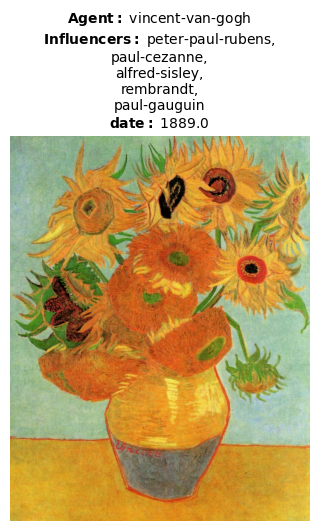

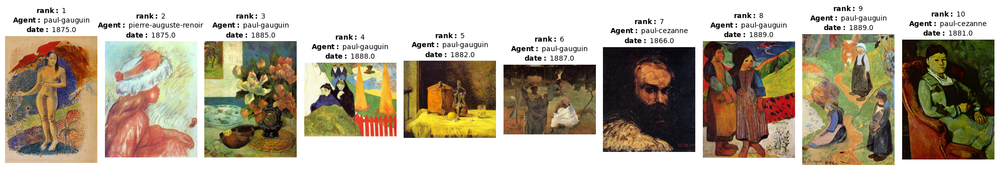

    
Experiment:posfaiss and 10 
Pk: 0.111, MRR: 0.217
2Pk: 0.172, 2MRR: 0.304


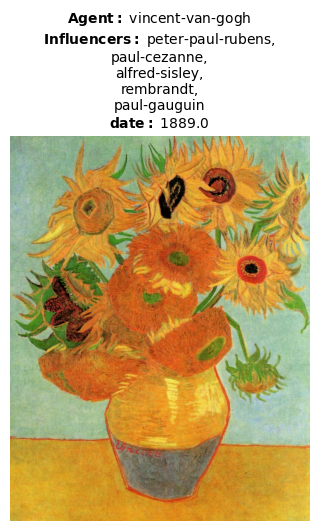

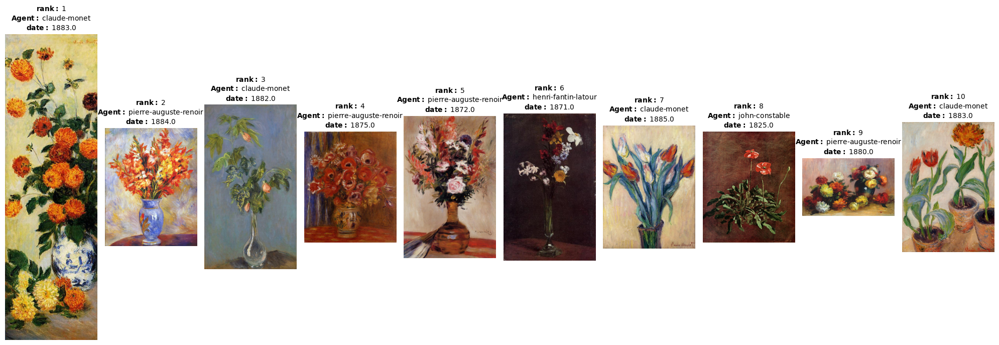

    
Experiment:posrandom and 100 
Pk: 0.161, MRR: 0.25
2Pk: 0.216, 2MRR: 0.321


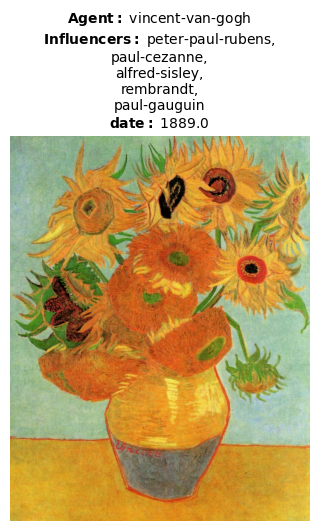

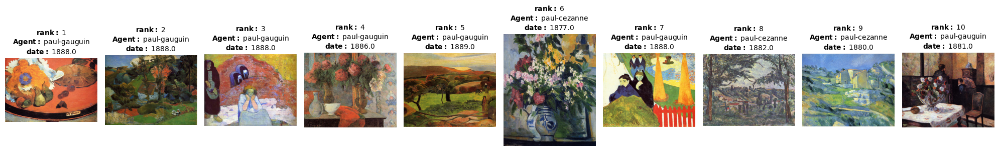

    
Experiment:posfaiss and 100 
Pk: 0.175, MRR: 0.276
2Pk: 0.239, 2MRR: 0.352


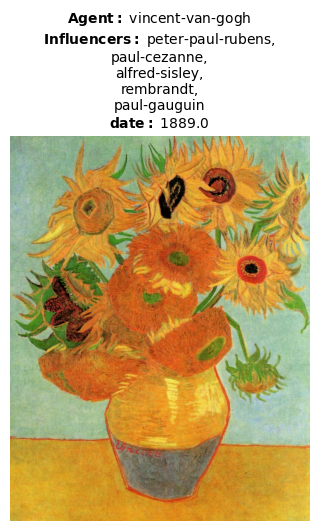

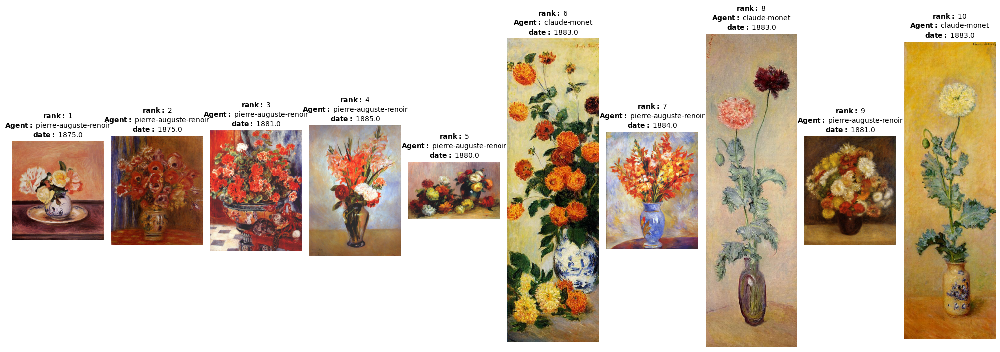

    
----------
BASELINE with random_artists, image_features
Pk: 0.098, MRR: 0.187
2Pk: 0.127, 2MRR: 0.233
     
Experiment:posrandom and 10 
Pk: 0.06, MRR: 0.127
2Pk: 0.081, 2MRR: 0.166


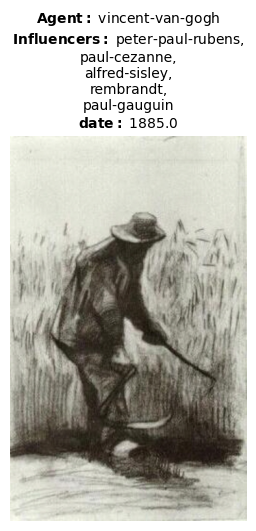

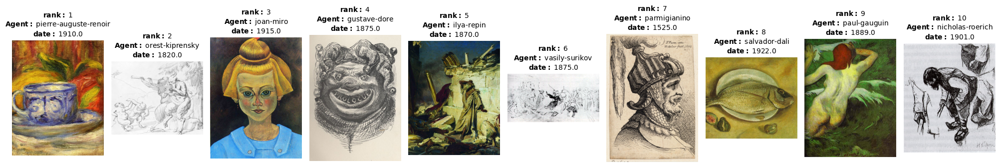

    
Experiment:posfaiss and 10 
Pk: 0.06, MRR: 0.13
2Pk: 0.082, 2MRR: 0.169


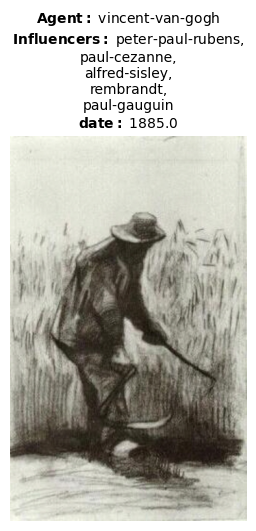

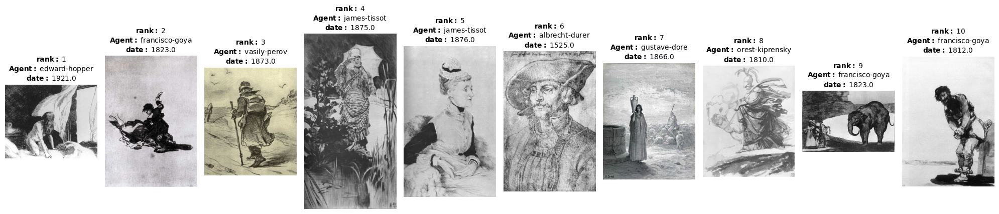

    
Experiment:posrandom and 100 
Pk: 0.061, MRR: 0.129
2Pk: 0.083, 2MRR: 0.166


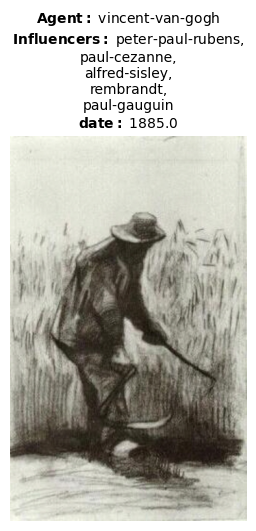

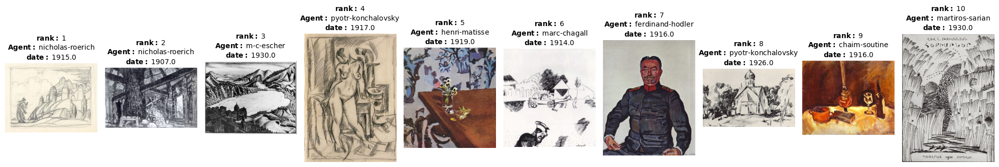

    
Experiment:posfaiss and 100 
Pk: 0.105, MRR: 0.195
2Pk: 0.135, 2MRR: 0.24


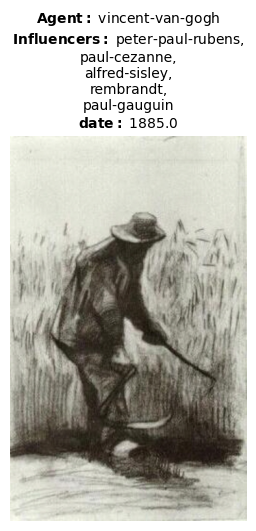

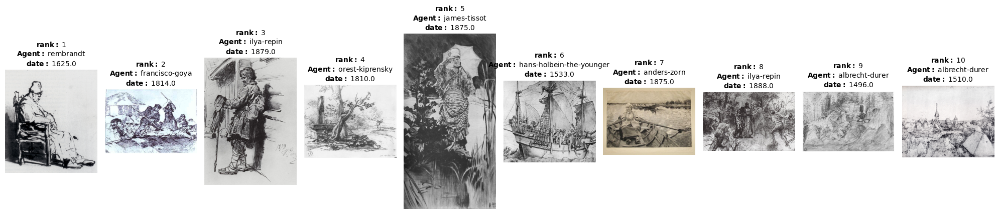

    
----------
BASELINE with ResNet34_newsplit, image_text_features
Pk: 0.092, MRR: 0.181
2Pk: 0.145, 2MRR: 0.264
     
Experiment:posrandom and 10 
Pk: 0.242, MRR: 0.302
2Pk: 0.269, 2MRR: 0.328


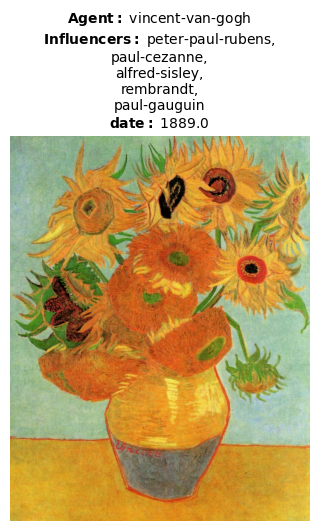

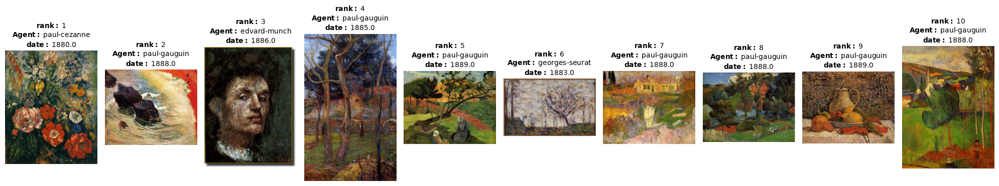

    
Experiment:posfaiss and 10 
Pk: 0.106, MRR: 0.201
2Pk: 0.158, 2MRR: 0.273


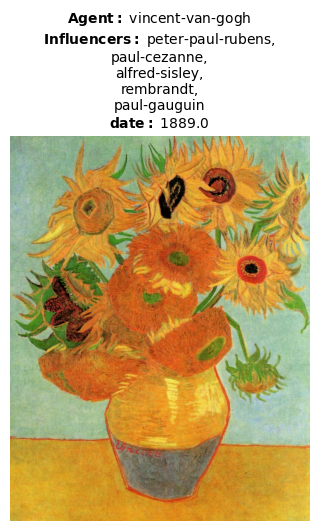

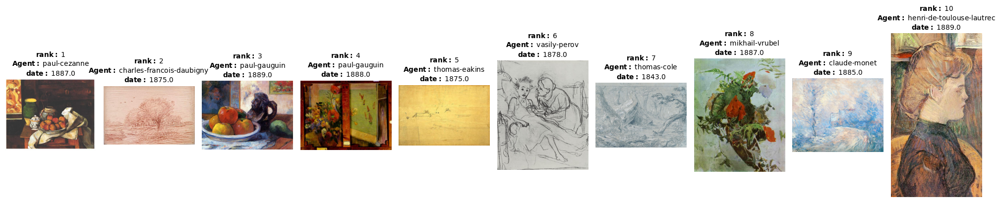

    
Experiment:posrandom and 100 
Pk: 0.353, MRR: 0.38
2Pk: 0.377, 2MRR: 0.404


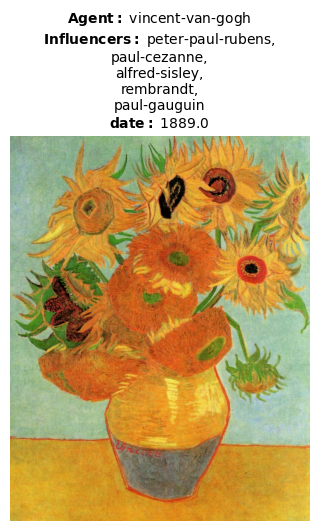

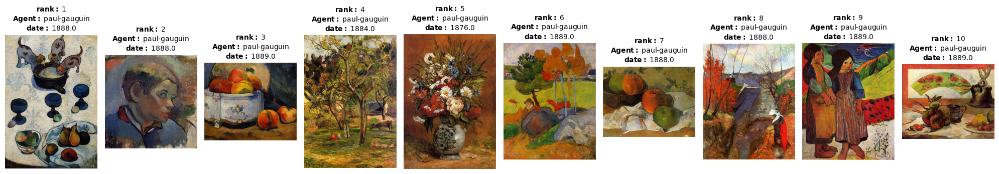

    
Experiment:posfaiss and 100 
Pk: 0.346, MRR: 0.419
2Pk: 0.383, 2MRR: 0.453


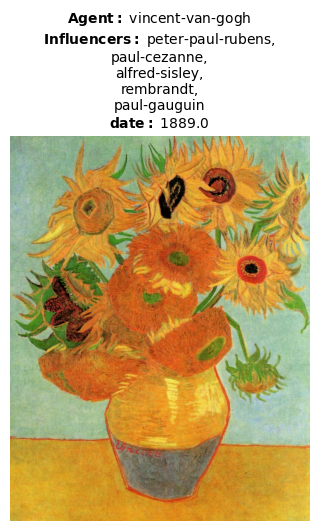

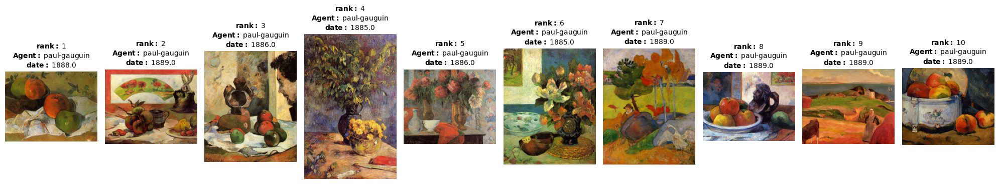

    
----------
BASELINE with random_artists, image_text_features
Pk: 0.059, MRR: 0.13
2Pk: 0.082, 2MRR: 0.171
     
Experiment:posrandom and 10 
Pk: 0.103, MRR: 0.173
2Pk: 0.125, 2MRR: 0.202


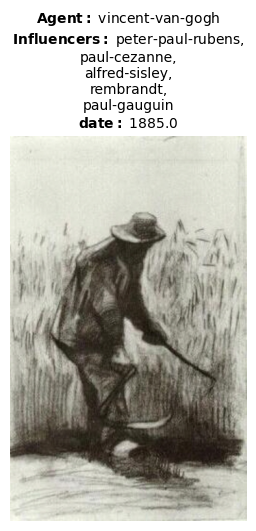

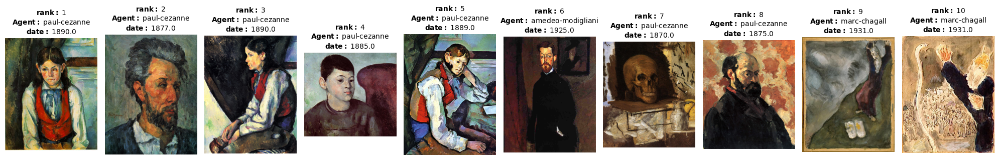

    
Experiment:posfaiss and 10 
Pk: 0.08, MRR: 0.164
2Pk: 0.103, 2MRR: 0.203


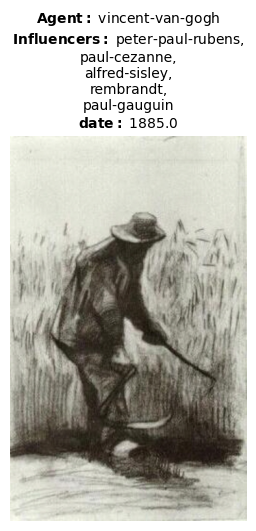

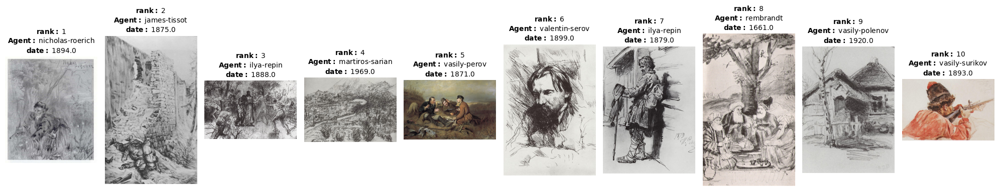

    
Experiment:posrandom and 100 
Pk: 0.093, MRR: 0.179
2Pk: 0.113, 2MRR: 0.207


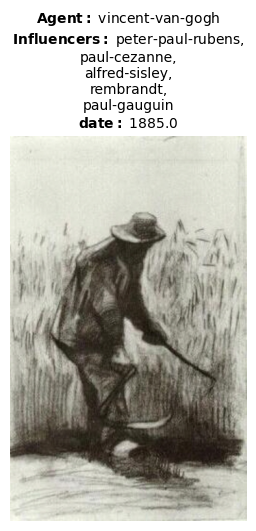

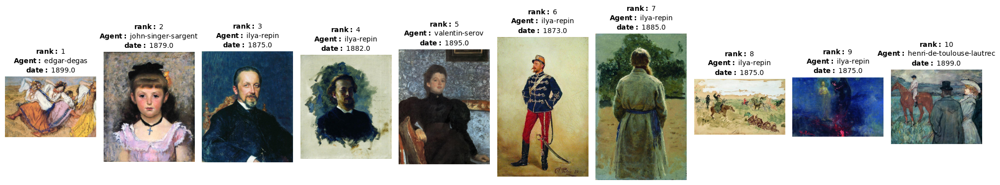

    
Experiment:posfaiss and 100 
Pk: 0.1, MRR: 0.172
2Pk: 0.122, 2MRR: 0.208


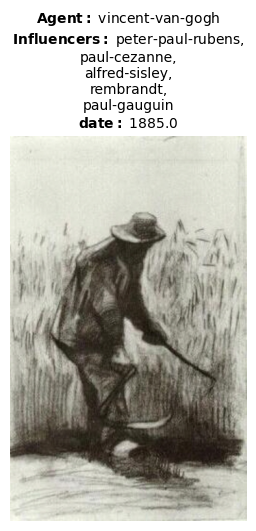

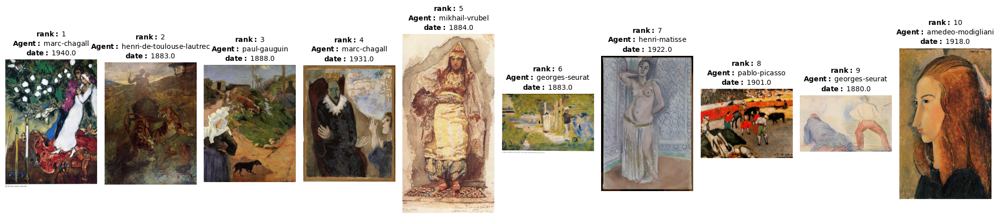

    
----------


In [4]:
print_metrics("wikiart", True)

iDESIGNER ANALYSIS